### Import packages

In [191]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import copy
import math

%matplotlib inline

In [192]:
# pip install ydata-profiling
from ydata_profiling import ProfileReport

### Read data

In [193]:
data = pd.read_csv("churn-tele-small.csv", thousands=',', skipinitialspace=True)
#data = pd.read_csv("churn-bigml-80.csv", thousands=',', skipinitialspace=True)
data

,State,Account length,Area code,International plan,Voice mail plan,Number vmail messages,Total day minutes,Total day calls,Total day charge,Total eve minutes,Total eve calls,Total eve charge,Total night minutes,Total night calls,Total night charge,Total intl minutes,Total intl calls,Total intl charge,Customer service calls,Churn
0,LA,117,408,No,No,0,184.5,97,31.37,351.6,80,29.89,215.8,90,9.71,8.7,4,2.35,1,False
1,IN,65,415,No,No,0,129.1,137,21.95,228.5,83,19.42,208.8,111,9.40,12.7,6,3.43,4,True
2,NY,161,415,No,No,0,332.9,67,56.59,317.8,97,27.01,160.6,128,7.23,5.4,9,1.46,4,True
3,SC,111,415,No,No,0,110.4,103,18.77,137.3,102,11.67,189.6,105,8.53,7.7,6,2.08,2,False
4,HI,49,510,No,No,0,119.3,117,20.28,215.1,109,18.28,178.7,90,8.04,11.1,1,3.00,1,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
662,WI,114,415,No,Yes,26,137.1,88,23.31,155.7,125,13.23,247.6,94,11.14,11.5,7,3.11,2,False
663,AL,106,408,No,Yes,29,83.6,131,14.21,203.9,131,17.33,229.5,73,10.33,8.1,3,2.19,1,False
664,VT,60,415,No,No,0,193.9,118,32.96,85.0,110,7.23,210.1,134,9.45,13.2,8,3.56,3,False
665,WV,159,415,No,No,0,169.8,114,28.87,197.7,105,16.80,193.7,82,8.72,11.6,4,3.13,1,False


### Drop empty lines in data and remove NAN's

In [194]:
data = data.dropna()
data

,State,Account length,Area code,International plan,Voice mail plan,Number vmail messages,Total day minutes,Total day calls,Total day charge,Total eve minutes,Total eve calls,Total eve charge,Total night minutes,Total night calls,Total night charge,Total intl minutes,Total intl calls,Total intl charge,Customer service calls,Churn
0,LA,117,408,No,No,0,184.5,97,31.37,351.6,80,29.89,215.8,90,9.71,8.7,4,2.35,1,False
1,IN,65,415,No,No,0,129.1,137,21.95,228.5,83,19.42,208.8,111,9.40,12.7,6,3.43,4,True
2,NY,161,415,No,No,0,332.9,67,56.59,317.8,97,27.01,160.6,128,7.23,5.4,9,1.46,4,True
3,SC,111,415,No,No,0,110.4,103,18.77,137.3,102,11.67,189.6,105,8.53,7.7,6,2.08,2,False
4,HI,49,510,No,No,0,119.3,117,20.28,215.1,109,18.28,178.7,90,8.04,11.1,1,3.00,1,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
662,WI,114,415,No,Yes,26,137.1,88,23.31,155.7,125,13.23,247.6,94,11.14,11.5,7,3.11,2,False
663,AL,106,408,No,Yes,29,83.6,131,14.21,203.9,131,17.33,229.5,73,10.33,8.1,3,2.19,1,False
664,VT,60,415,No,No,0,193.9,118,32.96,85.0,110,7.23,210.1,134,9.45,13.2,8,3.56,3,False
665,WV,159,415,No,No,0,169.8,114,28.87,197.7,105,16.80,193.7,82,8.72,11.6,4,3.13,1,False


### Reset the index for potentially removed rows in data

In [195]:
data = data.reset_index(drop=True)

## EDA - Exploratory Data Analysis

### View data statistics - short format

In [196]:
data.describe()

,Account length,Area code,Number vmail messages,Total day minutes,Total day calls,Total day charge,Total eve minutes,Total eve calls,Total eve charge,Total night minutes,Total night calls,Total night charge,Total intl minutes,Total intl calls,Total intl charge,Customer service calls
count,667.000000,667.000000,667.000000,667.000000,667.000000,667.000000,667.000000,667.000000,667.000000,667.000000,667.000000,667.000000,667.000000,667.000000,667.000000,667.000000
mean,102.841079,436.157421,8.407796,180.948126,100.937031,30.761769,203.355322,100.476762,17.285262,199.685307,100.113943,8.985907,10.238381,4.527736,2.764948,1.563718
std,40.819480,41.783305,13.994480,55.508628,20.396790,9.436463,49.719268,18.948262,4.226160,49.759931,20.172505,2.239429,2.807850,2.482442,0.758167,1.333357
min,1.000000,408.000000,0.000000,25.900000,30.000000,4.400000,48.100000,37.000000,4.090000,23.200000,42.000000,1.040000,0.000000,0.000000,0.000000,0.000000
25%,76.000000,408.000000,0.000000,146.250000,87.500000,24.860000,171.050000,88.000000,14.540000,167.950000,86.000000,7.560000,8.600000,3.000000,2.320000,1.000000
50%,102.000000,415.000000,0.000000,178.300000,101.000000,30.310000,203.700000,101.000000,17.310000,201.600000,100.000000,9.070000,10.500000,4.000000,2.840000,1.000000
75%,128.000000,415.000000,20.000000,220.700000,115.000000,37.520000,236.450000,113.000000,20.095000,231.500000,113.500000,10.420000,12.050000,6.000000,3.255000,2.000000
max,232.000000,510.000000,51.000000,334.300000,165.000000,56.830000,361.800000,168.000000,30.750000,367.700000,175.000000,16.550000,18.300000,18.000000,4.940000,8.000000


### View data statistics - long format

In [197]:
profile = ProfileReport(data, title="Telecom Customer Churn")

In [20]:
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

#### Important: We have 85.8% samples with no churn and 14.2% churn samples in our dataset

### Change categorical string/boolean columns to categorical integer columns

In [198]:
data['State'] = data['State'].astype('category').cat.codes
data['International plan'] = data['International plan'].astype('category').cat.codes
data['Voice mail plan'] = data['Voice mail plan'].astype('category').cat.codes
data['Churn'] = data['Churn'].astype('category').cat.codes

In [199]:
data

,State,Account length,Area code,International plan,Voice mail plan,Number vmail messages,Total day minutes,Total day calls,Total day charge,Total eve minutes,Total eve calls,Total eve charge,Total night minutes,Total night calls,Total night charge,Total intl minutes,Total intl calls,Total intl charge,Customer service calls,Churn
0,18,117,408,0,0,0,184.5,97,31.37,351.6,80,29.89,215.8,90,9.71,8.7,4,2.35,1,0
1,15,65,415,0,0,0,129.1,137,21.95,228.5,83,19.42,208.8,111,9.40,12.7,6,3.43,4,1
2,34,161,415,0,0,0,332.9,67,56.59,317.8,97,27.01,160.6,128,7.23,5.4,9,1.46,4,1
3,40,111,415,0,0,0,110.4,103,18.77,137.3,102,11.67,189.6,105,8.53,7.7,6,2.08,2,0
4,11,49,510,0,0,0,119.3,117,20.28,215.1,109,18.28,178.7,90,8.04,11.1,1,3.00,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
662,48,114,415,0,1,26,137.1,88,23.31,155.7,125,13.23,247.6,94,11.14,11.5,7,3.11,2,0
663,1,106,408,0,1,29,83.6,131,14.21,203.9,131,17.33,229.5,73,10.33,8.1,3,2.19,1,0
664,46,60,415,0,0,0,193.9,118,32.96,85.0,110,7.23,210.1,134,9.45,13.2,8,3.56,3,0
665,49,159,415,0,0,0,169.8,114,28.87,197.7,105,16.80,193.7,82,8.72,11.6,4,3.13,1,0


### Create x and y from original data

In [200]:
x_data = data.drop(columns=['Churn'])
x_data

,State,Account length,Area code,International plan,Voice mail plan,Number vmail messages,Total day minutes,Total day calls,Total day charge,Total eve minutes,Total eve calls,Total eve charge,Total night minutes,Total night calls,Total night charge,Total intl minutes,Total intl calls,Total intl charge,Customer service calls
0,18,117,408,0,0,0,184.5,97,31.37,351.6,80,29.89,215.8,90,9.71,8.7,4,2.35,1
1,15,65,415,0,0,0,129.1,137,21.95,228.5,83,19.42,208.8,111,9.40,12.7,6,3.43,4
2,34,161,415,0,0,0,332.9,67,56.59,317.8,97,27.01,160.6,128,7.23,5.4,9,1.46,4
3,40,111,415,0,0,0,110.4,103,18.77,137.3,102,11.67,189.6,105,8.53,7.7,6,2.08,2
4,11,49,510,0,0,0,119.3,117,20.28,215.1,109,18.28,178.7,90,8.04,11.1,1,3.00,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
662,48,114,415,0,1,26,137.1,88,23.31,155.7,125,13.23,247.6,94,11.14,11.5,7,3.11,2
663,1,106,408,0,1,29,83.6,131,14.21,203.9,131,17.33,229.5,73,10.33,8.1,3,2.19,1
664,46,60,415,0,0,0,193.9,118,32.96,85.0,110,7.23,210.1,134,9.45,13.2,8,3.56,3
665,49,159,415,0,0,0,169.8,114,28.87,197.7,105,16.80,193.7,82,8.72,11.6,4,3.13,1


In [201]:
y_data = data[['Churn']]
y_data

,Churn
0,0
1,1
2,1
3,0
4,0
...,...
662,0
663,0
664,0
665,0


### View features against Churn

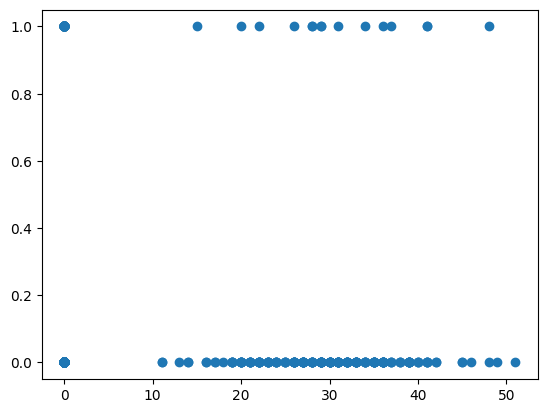

In [202]:
plt.scatter(x_data['Number vmail messages'], y_data)

### Split data into training and validation datasets: Default 80% train, 20% validation

In [203]:
def train_validation_split(x, y, validation_size=0.2, random_state=None):
    x_validation = x.sample(frac=validation_size, random_state=random_state)
    y_validation = y.iloc[x_validation.index]
    
    x_train = x.drop(x_validation.index)
    y_train = y.drop(y_validation.index)

    return np.array(x_train), np.array(y_train), np.array(x_validation), np.array(y_validation)

In [204]:
x_train, y_train, x_validation, y_validation = train_validation_split(x_data, y_data, validation_size=0.2, random_state=0)

### Visualize how one sample looks like

In [205]:
x_train[0]

array([ 18.  , 117.  , 408.  ,   0.  ,   0.  ,   0.  , 184.5 ,  97.  ,
        31.37, 351.6 ,  80.  ,  29.89, 215.8 ,  90.  ,   9.71,   8.7 ,
         4.  ,   2.35,   1.  ])

### Visualize the nuber of training samples and number of validation samples

In [206]:
len(y_train), len(y_validation)

(534, 133)

### Visualize the number of no churn vs churn samples in training dataset

#### Having 85.8% samples with no churn and 14.2% samples with churn in our dataset
#### So we have a ratio of 6 no churn samples to 1 churn sample
#### Our training and validation dataset should respect this ratio approximately

In [207]:
np.unique(y_train, return_counts=True)

(array([0, 1], dtype=int8), array([456,  78], dtype=int64))

#### 456 samples of 0 (no churn) and 78 samples of 1 (churn)
#### 78 * 6 = 468

### Visualize the number of no churn vs churn samples in validation dataset

#### 116 samples of 0 (no churn) and 17 samples of 1 (churn)
#### 17 * 6 = 102

In [208]:
np.unique(y_validation, return_counts=True)

(array([0, 1], dtype=int8), array([116,  17], dtype=int64))

### Standardization - mean and standard deviation calculation

In [209]:
mean   = np.mean(x_train, axis=0)
sigma  = np.std(x_train, axis=0)

In [210]:
x_train = (x_train - mean) / sigma

### Very important! Validation dataset MUST BE standardized using mean and standard deviation calculated from the training dataset

In [211]:
x_validation = (x_validation - mean) / sigma

### View min and max values after standardization from training dataset

In [212]:
x_train.min(), x_train.max()

(-3.536330892785862, 5.425477734809181)

### View min and max values after standardization from training dataset

In [213]:
x_validation.min(), x_validation.max()

(-3.4861105004673703, 4.217805742150531)

### Logistic Regression implementation

In [214]:
def sigmoid(x):
    g = 1 / (1 + np.exp(-x))
    return g

#### Examples of using sigmoid values

In [215]:
sigmoid(1)

0.7310585786300049

In [216]:
sigmoid(0)

0.5

In [217]:
sigmoid(-1)

0.2689414213699951

In [218]:
sigmoid(-1000)

C:\Users\alexa\AppData\Local\Temp\ipykernel_26616\3992194360.py:2: RuntimeWarning: overflow encountered in exp
  g = 1 / (1 + np.exp(-x))


0.0

In [219]:
sigmoid(100)

1.0

In [220]:
def compute_cost(X, y, w, b, lambda_=1):
    m = X.shape[0]
    cost = 0.0
    for i in range(m):
        z_i = np.dot(X[i],w) + b
        f_wb_i = sigmoid(z_i)
        cost +=  -y[i] * np.log(f_wb_i) - (1 - y[i]) * np.log(1 - f_wb_i) 
             
    cost = cost / m
    return cost

In [221]:
def compute_gradient(X, y, w, b, lambda_=1):
    m,n = X.shape
    dj_dw = np.zeros((n,))                           #(n,)
    dj_db = 0.

    for i in range(m):
        f_wb_i = sigmoid(np.dot(X[i], w) + b)          #(n,)(n,)=scalar
        err_i  = f_wb_i  - y[i]                       #scalar
        for j in range(n):
            dj_dw[j] += err_i * X[i,j]      #scalar
        dj_db += err_i
    dj_dw = dj_dw/m                                   #(n,)
    dj_db = dj_db/m                                   #scalar
        
    return dj_db, dj_dw

In [222]:
def gradient_descent(x_train, y_train, x_validation, y_validation, w_in, b_in, cost_function, gradient_function, alpha, num_iters, lambda_=1):    
    # number of training examples
    m = len(x_train)
    
    # An array to store cost J and w's at each iteration primarily for graphing later
    J_train_history = []
    J_valid_history = []
    w_history = []

    best_train_score = cost_function(x_train, y_train, w_in, b_in, lambda_)
    best_validation_score = cost_valid =  compute_cost(x_validation, y_validation, w_in, b_in, lambda_)
    best_w_in_train = copy.deepcopy(w_in)
    best_b_train = copy.deepcopy(b_in)
    best_w_in_valid = copy.deepcopy(w_in)
    best_b_valid = copy.deepcopy(b_in)
    
    for i in range(num_iters):
        
        # Calculate the gradient and update the parameters
        dj_db, dj_dw = gradient_function(x_train, y_train, w_in, b_in, lambda_)   

        # Update Parameters using w, b, alpha and gradient
        w_in = w_in - alpha * dj_dw               
        b_in = b_in - alpha * dj_db              
        
        cost_train =  cost_function(x_train, y_train, w_in, b_in, lambda_)
        J_train_history.append(cost_train)

        cost_valid =  compute_cost(x_validation, y_validation, w_in, b_in, lambda_)
        J_valid_history.append(cost_valid)

        if best_train_score > cost_train:
            best_train_score = cost_train
            np.save(f'model/best_train_w_in.npy', w_in)    # .npy extension is added if not given
            np.save(f'model/best_train_b.npy', b_in) 


        if best_validation_score > cost_valid:
            best_validation_score = cost_valid
            np.save(f'model/best_valid_w_in.npy', w_in)    # .npy extension is added if not given
            np.save(f'model/best_valid_b.npy', b_in) 
        
        # Print cost every at intervals 10 times or as many iterations if < 10
        if i % math.ceil(num_iters/10) == 0 or i == (num_iters-1):
            w_history.append(w_in)
            print(f"Iteration {i:4}: Cost Train: {float(J_train_history[-1].squeeze()):f} \t  Cost Validation: {float(J_valid_history[-1].squeeze()):f}")
        
    return w_in, b_in, J_train_history, J_valid_history, w_history #return w and J,w history for graphing

In [223]:
initial_w = np.zeros(len(x_train[0]))
initial_b = 0

# Some gradient descent settings
iterations = 1000
alpha = 3
lambda_ = 0

w_final, b_final, J_train_history, J_valid_history, _ = gradient_descent(x_train=x_train, y_train=y_train, x_validation=x_validation, y_validation=y_validation, w_in=initial_w, b_in=initial_b, cost_function=compute_cost, gradient_function=compute_gradient, alpha=alpha, num_iters=iterations, lambda_=lambda_)

C:\Users\alexa\AppData\Local\Temp\ipykernel_26616\2253367060.py:10: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  dj_dw[j] += err_i * X[i,j]      #scalar


Iteration    0: Cost Train: 0.385570 	  Cost Validation: 0.407384
Iteration  100: Cost Train: 0.291262 	  Cost Validation: 0.372524
Iteration  200: Cost Train: 0.291252 	  Cost Validation: 0.372209
Iteration  300: Cost Train: 0.291250 	  Cost Validation: 0.372074
Iteration  400: Cost Train: 0.291249 	  Cost Validation: 0.372017
Iteration  500: Cost Train: 0.291249 	  Cost Validation: 0.371992
Iteration  600: Cost Train: 0.291248 	  Cost Validation: 0.371982
Iteration  700: Cost Train: 0.291247 	  Cost Validation: 0.371979
Iteration  800: Cost Train: 0.291247 	  Cost Validation: 0.371978
Iteration  900: Cost Train: 0.291246 	  Cost Validation: 0.371978
Iteration  999: Cost Train: 0.291246 	  Cost Validation: 0.371978


In [224]:
best_w_final = np.load('model/best_valid_w_in.npy')
best_b_final = np.load('model/best_valid_b.npy')

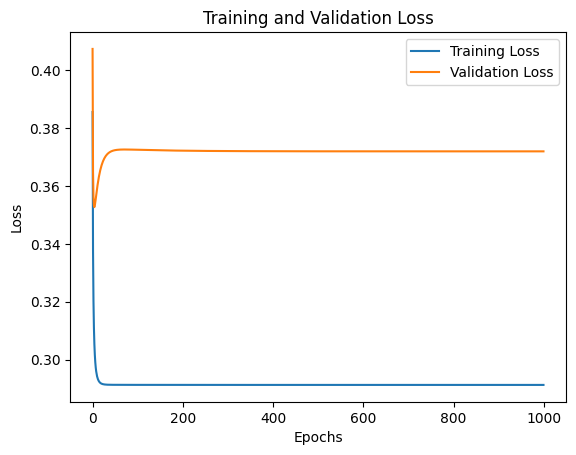

In [225]:
# Generate a sequence of integers to represent the epoch numbers
#epochs = range(1, iterations+1)
 
# Plot and label the training and validation loss values
plt.plot(J_train_history, label='Training Loss')
plt.plot(J_valid_history, label='Validation Loss')
 
# Add in a title and axes labels
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
 
# Set the tick locations
#plt.xticks(np.arange(0, iterations+1, 2))
 
# Display the plot
plt.legend(loc='best')
plt.show()

In [226]:
def predict(X, w, b):
    # number of training examples
    m, n = X.shape   
    p = np.zeros(m)
    
    for i in range(m):   
        z_wb = 0
        # Loop over each feature
        for j in range(n): 
            # Add the corresponding term to z_wb
            z_wb += X[i][j] * w[j]
        
        # Add bias term 
        z_wb += b
        
        # Calculate the prediction for this example
        f_wb = sigmoid(z_wb)

        # Apply the threshold
        p[i] = f_wb >= 0.5
        
    return p

In [227]:
y_predicted = predict(x_train, w_final, b_final)

C:\Users\alexa\AppData\Local\Temp\ipykernel_26616\7029633.py:20: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  p[i] = f_wb >= 0.5


In [228]:
y_train.shape

(534, 1)

In [229]:
y_train.reshape(-1).shape, y_predicted.shape

((534,), (534,))

In [230]:
(y_train.reshape(-1) == y_predicted).sum()

464

In [231]:
x_train.shape
x_train.shape

(534, 19)

In [232]:
y_train = y_train.reshape(-1)

In [233]:
type(y_predicted)

numpy.ndarray

In [234]:
def metrics_computations(x:np.array,
                         y_true:np.array,
                         y_predicted: np.array):
    total_number_of_samples = x.shape[0]
    accuracy = (y_true == y_predicted).sum() / total_number_of_samples
    true_positive = ((y_predicted == 1) & (y_true == 1)).sum()
    false_positive = ((y_predicted == 1) & (y_true == 0)).sum()
    false_negative = ((y_predicted == 0) & (y_true == 1)).sum()
    true_negative = ((y_predicted == 0) & (y_true == 0)).sum()
    
    precision = true_positive / (true_positive + false_positive)
    recall = true_positive / (true_positive + false_negative)
    specificity = true_negative / (true_negative + false_positive)
    f1_score = (2 * precision * recall) / (precision + recall)
    
    false_negative_rate = false_negative / (false_negative + true_positive)
    false_positive_rate = false_positive / (false_positive + true_negative)

    return (accuracy, precision, recall, specificity, f1_score, false_negative_rate, false_positive_rate)

In [235]:
(accuracy, precision, recall, specificity, f1_score, false_negative_rate, false_positive_rate) = metrics_computations(x=x_train,
                                                                                                                     y_true=y_train,
                                                                                                                     y_predicted=y_predicted)

In [236]:
print(f"[TRAIN] Accuracy: {(accuracy * 100.):.2f}% \n Precision: {(precision * 100):.2f}% \n Recall: {(recall * 100):.2f}% \n F1 Score: {(f1_score * 100.):.2f}% \n Specificity: {(specificity * 100):.2f}% \n False Positive Rate: {(false_positive_rate * 100):.2f}% \n False Negative Rate: {(false_negative_rate * 100):.2f}%")

[TRAIN] Accuracy: 86.89% 
 Precision: 60.53% 
 Recall: 29.49% 
 F1 Score: 39.66% 
 Specificity: 96.71% 
 False Positive Rate: 3.29% 
 False Negative Rate: 70.51%


In [69]:
print(f"[TRAIN] Accuracy: {(accuracy * 100.):.2f}% \n Precision: {(precision * 100):.2f}% \n Recall: {(recall * 100):.2f}% \n F1 Score: {(f1_score * 100.):.2f}% \n Specificity: {(specificity * 100):.2f}% \n False Positive Rate: {(false_positive_rate * 100):.2f}% \n False Negative Rate: {(false_negative_rate * 100):.2f}%")

[TRAIN] Accuracy: 86.52% 
 Precision: 58.82% 
 Recall: 25.64% 
 F1 Score: 35.71% 
 Specificity: 96.93% 
 False Positive Rate: 3.07% 
 False Negative Rate: 74.36%


In [237]:
y_predicted_validation = predict(x_validation, w_final, b_final)

C:\Users\alexa\AppData\Local\Temp\ipykernel_26616\7029633.py:20: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  p[i] = f_wb >= 0.5


In [238]:
y_validation = y_validation.reshape(-1)

In [239]:
for i, j in zip(y_validation, y_predicted_validation):
    print(i, j)

0 1.0
0 0.0
1 0.0
0 0.0
0 0.0
0 1.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
1 0.0
0 0.0
0 0.0
0 0.0
0 0.0
1 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
1 0.0
1 0.0
0 0.0
0 0.0
0 0.0
1 0.0
1 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
1 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
1 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
1 1.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
1 0.0
1 0.0
0 0.0
0 0.0
0 0.0
0 0.0
1 1.0
0 0.0
0 1.0
0 0.0
0 0.0
0 0.0
1 0.0
0 0.0
1 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
1 0.0
0 0.0
0 0.0
0 1.0
0 0.0
1 1.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 0.0
0 1.0


In [240]:
(accuracy, precision, recall, specificity, f1_score, false_negative_rate, false_positive_rate) = metrics_computations(x=x_validation,
                                                                                                                     y_true=y_validation,
                                                                                                                     y_predicted=y_predicted_validation)

In [241]:
print(f"[Valid] Accuracy: {(accuracy * 100.):.2f}% \n Precision: {(precision * 100):.2f}% \n Recall: {(recall * 100):.2f}% \n F1 Score: {(f1_score * 100.):.2f}% \n Specificity: {(specificity * 100):.2f}% \n False Positive Rate: {(false_positive_rate * 100):.2f}% \n False Negative Rate: {(false_negative_rate * 100):.2f}%")

[Valid] Accuracy: 85.71% 
 Precision: 37.50% 
 Recall: 17.65% 
 F1 Score: 24.00% 
 Specificity: 95.69% 
 False Positive Rate: 4.31% 
 False Negative Rate: 82.35%


In [74]:
print(f"[Valid] Accuracy: {(accuracy * 100.):.2f}% \n Precision: {(precision * 100):.2f}% \n Recall: {(recall * 100):.2f}% \n F1 Score: {(f1_score * 100.):.2f}% \n Specificity: {(specificity * 100):.2f}% \n False Positive Rate: {(false_positive_rate * 100):.2f}% \n False Negative Rate: {(false_negative_rate * 100):.2f}%")

[Valid] Accuracy: 86.47% 
 Precision: 42.86% 
 Recall: 17.65% 
 F1 Score: 25.00% 
 Specificity: 96.55% 
 False Positive Rate: 3.45% 
 False Negative Rate: 82.35%


### Analyze the feature importance

<Axes: ylabel='Feature'>

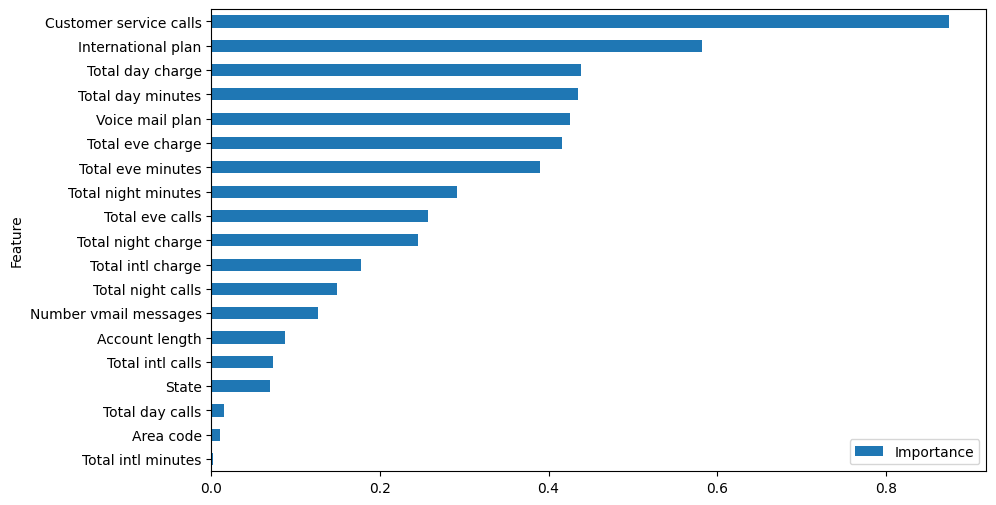

In [242]:
coefficients = copy.deepcopy(w_final)

feature_importance = pd.DataFrame({'Feature': x_data.columns.values, 'Importance': np.abs(coefficients)})
feature_importance = feature_importance.sort_values('Importance', ascending=True)
feature_importance.plot(x='Feature', y='Importance', kind='barh', figsize=(10, 6))

### Add polynomial features for improving model capacity

In [243]:
#pip install scikit-learn
from sklearn import preprocessing

In [244]:
poly = preprocessing.PolynomialFeatures(2, interaction_only=False, include_bias=False)

In [245]:
poly_values = poly.fit_transform(x_data)
poly_values

array([[ 18.    , 117.    , 408.    , ...,   5.5225,   2.35  ,   1.    ],
       [ 15.    ,  65.    , 415.    , ...,  11.7649,  13.72  ,  16.    ],
       [ 34.    , 161.    , 415.    , ...,   2.1316,   5.84  ,  16.    ],
       ...,
       [ 46.    ,  60.    , 415.    , ...,  12.6736,  10.68  ,   9.    ],
       [ 49.    , 159.    , 415.    , ...,   9.7969,   3.13  ,   1.    ],
       [  6.    , 184.    , 510.    , ...,   1.8225,   2.7   ,   4.    ]])

In [246]:
poly_column_names = list(poly.get_feature_names_out(x_data.columns))
poly_column_names

['State',
 'Account length',
 'Area code',
 'International plan',
 'Voice mail plan',
 'Number vmail messages',
 'Total day minutes',
 'Total day calls',
 'Total day charge',
 'Total eve minutes',
 'Total eve calls',
 'Total eve charge',
 'Total night minutes',
 'Total night calls',
 'Total night charge',
 'Total intl minutes',
 'Total intl calls',
 'Total intl charge',
 'Customer service calls',
 'State^2',
 'State Account length',
 'State Area code',
 'State International plan',
 'State Voice mail plan',
 'State Number vmail messages',
 'State Total day minutes',
 'State Total day calls',
 'State Total day charge',
 'State Total eve minutes',
 'State Total eve calls',
 'State Total eve charge',
 'State Total night minutes',
 'State Total night calls',
 'State Total night charge',
 'State Total intl minutes',
 'State Total intl calls',
 'State Total intl charge',
 'State Customer service calls',
 'Account length^2',
 'Account length Area code',
 'Account length International plan',
 '

In [247]:
x_data = pd.DataFrame(poly_values, columns=poly_column_names)
x_data

,State,Account length,Area code,International plan,Voice mail plan,Number vmail messages,Total day minutes,Total day calls,Total day charge,Total eve minutes,...,Total intl minutes^2,Total intl minutes Total intl calls,Total intl minutes Total intl charge,Total intl minutes Customer service calls,Total intl calls^2,Total intl calls Total intl charge,Total intl calls Customer service calls,Total intl charge^2,Total intl charge Customer service calls,Customer service calls^2
0,18.0,117.0,408.0,0.0,0.0,0.0,184.5,97.0,31.37,351.6,...,75.69,34.8,20.445,8.7,16.0,9.40,4.0,5.5225,2.35,1.0
1,15.0,65.0,415.0,0.0,0.0,0.0,129.1,137.0,21.95,228.5,...,161.29,76.2,43.561,50.8,36.0,20.58,24.0,11.7649,13.72,16.0
2,34.0,161.0,415.0,0.0,0.0,0.0,332.9,67.0,56.59,317.8,...,29.16,48.6,7.884,21.6,81.0,13.14,36.0,2.1316,5.84,16.0
3,40.0,111.0,415.0,0.0,0.0,0.0,110.4,103.0,18.77,137.3,...,59.29,46.2,16.016,15.4,36.0,12.48,12.0,4.3264,4.16,4.0
4,11.0,49.0,510.0,0.0,0.0,0.0,119.3,117.0,20.28,215.1,...,123.21,11.1,33.300,11.1,1.0,3.00,1.0,9.0000,3.00,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
662,48.0,114.0,415.0,0.0,1.0,26.0,137.1,88.0,23.31,155.7,...,132.25,80.5,35.765,23.0,49.0,21.77,14.0,9.6721,6.22,4.0
663,1.0,106.0,408.0,0.0,1.0,29.0,83.6,131.0,14.21,203.9,...,65.61,24.3,17.739,8.1,9.0,6.57,3.0,4.7961,2.19,1.0
664,46.0,60.0,415.0,0.0,0.0,0.0,193.9,118.0,32.96,85.0,...,174.24,105.6,46.992,39.6,64.0,28.48,24.0,12.6736,10.68,9.0
665,49.0,159.0,415.0,0.0,0.0,0.0,169.8,114.0,28.87,197.7,...,134.56,46.4,36.308,11.6,16.0,12.52,4.0,9.7969,3.13,1.0


In [248]:
x_data.columns

Index(['State', 'Account length', 'Area code', 'International plan',
       'Voice mail plan', 'Number vmail messages', 'Total day minutes',
       'Total day calls', 'Total day charge', 'Total eve minutes',
       ...
       'Total intl minutes^2', 'Total intl minutes Total intl calls',
       'Total intl minutes Total intl charge',
       'Total intl minutes Customer service calls', 'Total intl calls^2',
       'Total intl calls Total intl charge',
       'Total intl calls Customer service calls', 'Total intl charge^2',
       'Total intl charge Customer service calls', 'Customer service calls^2'],
      dtype='object', length=209)

### Split data into training and validation datasets: Default 80% train, 20% validation

In [249]:
def train_validation_split(x, y, validation_size=0.2, random_state=None):
    x_validation = x.sample(frac=validation_size, random_state=random_state)
    y_validation = y.iloc[x_validation.index]
    
    x_train = x.drop(x_validation.index)
    y_train = y.drop(y_validation.index)

    return np.array(x_train), np.array(y_train), np.array(x_validation), np.array(y_validation)

In [250]:
x_train, y_train, x_validation, y_validation = train_validation_split(x_data, y_data, validation_size=0.2, random_state=0)

### Visualize how one sample looks like

In [251]:
x_train[0]

array([1.8000000e+01, 1.1700000e+02, 4.0800000e+02, 0.0000000e+00,
       0.0000000e+00, 0.0000000e+00, 1.8450000e+02, 9.7000000e+01,
       3.1370000e+01, 3.5160000e+02, 8.0000000e+01, 2.9890000e+01,
       2.1580000e+02, 9.0000000e+01, 9.7100000e+00, 8.7000000e+00,
       4.0000000e+00, 2.3500000e+00, 1.0000000e+00, 3.2400000e+02,
       2.1060000e+03, 7.3440000e+03, 0.0000000e+00, 0.0000000e+00,
       0.0000000e+00, 3.3210000e+03, 1.7460000e+03, 5.6466000e+02,
       6.3288000e+03, 1.4400000e+03, 5.3802000e+02, 3.8844000e+03,
       1.6200000e+03, 1.7478000e+02, 1.5660000e+02, 7.2000000e+01,
       4.2300000e+01, 1.8000000e+01, 1.3689000e+04, 4.7736000e+04,
       0.0000000e+00, 0.0000000e+00, 0.0000000e+00, 2.1586500e+04,
       1.1349000e+04, 3.6702900e+03, 4.1137200e+04, 9.3600000e+03,
       3.4971300e+03, 2.5248600e+04, 1.0530000e+04, 1.1360700e+03,
       1.0179000e+03, 4.6800000e+02, 2.7495000e+02, 1.1700000e+02,
       1.6646400e+05, 0.0000000e+00, 0.0000000e+00, 0.0000000e

### Visualize the nuber of training samples and number of validation samples

In [252]:
len(y_train), len(y_validation)

(534, 133)

### Visualize the number of no churn vs churn samples in training dataset

#### Having 85.8% samples with no churn and 14.2% samples with churn in our dataset
#### So we have a ratio of 6 no churn samples to 1 churn sample
#### Our training and validation dataset should respect this ratio approximately

In [253]:
np.unique(y_train, return_counts=True)

(array([0, 1], dtype=int8), array([456,  78], dtype=int64))

#### 456 samples of 0 (no churn) and 78 samples of 1 (churn)
#### 78 * 6 = 468

### Visualize the number of no churn vs churn samples in validation dataset

#### 116 samples of 0 (no churn) and 17 samples of 1 (churn)
#### 17 * 6 = 102

In [254]:
np.unique(y_validation, return_counts=True)

(array([0, 1], dtype=int8), array([116,  17], dtype=int64))

### Standardization - mean and standard deviation calculation

In [255]:
mean   = np.mean(x_train, axis=0)
sigma  = np.std(x_train, axis=0)

In [256]:
x_train = (x_train - mean) / sigma

### Very important! Validation dataset MUST BE standardized using mean and standard deviation calculated from the training dataset

In [257]:
x_validation = (x_validation - mean) / sigma

### View min and max values after standardization from training dataset

In [258]:
x_train.min(), x_train.max()

(-3.536330892785864, 9.551130842066444)

### View min and max values after standardization from training dataset

In [259]:
x_validation.min(), x_validation.max()

(-3.4861105004673734, 6.878924168793807)

### Train with polynomial features

In [260]:
def gradient_descent(x_train, y_train, x_validation, y_validation, w_in, b_in, cost_function, gradient_function, alpha, num_iters, lambda_=1):    
    # number of training examples
    m = len(x_train)
    
    # An array to store cost J and w's at each iteration primarily for graphing later
    J_train_history = []
    J_valid_history = []
    w_history = []

    best_train_score = cost_function(x_train, y_train, w_in, b_in, lambda_)
    best_validation_score = cost_valid =  compute_cost(x_validation, y_validation, w_in, b_in, lambda_)
    best_w_in_train = copy.deepcopy(w_in)
    best_b_train = copy.deepcopy(b_in)
    best_w_in_valid = copy.deepcopy(w_in)
    best_b_valid = copy.deepcopy(b_in)
    
    for i in range(num_iters):
        
        # Calculate the gradient and update the parameters
        dj_db, dj_dw = gradient_function(x_train, y_train, w_in, b_in, lambda_)   

        # Update Parameters using w, b, alpha and gradient
        w_in = w_in - alpha * dj_dw               
        b_in = b_in - alpha * dj_db              
        
        cost_train =  cost_function(x_train, y_train, w_in, b_in, lambda_)
        J_train_history.append(cost_train)

        cost_valid =  compute_cost(x_validation, y_validation, w_in, b_in, lambda_)
        J_valid_history.append(cost_valid)

        if best_train_score > cost_train:
            best_train_score = cost_train
            np.save(f'model/best_poly_train_w_in.npy', w_in)    # .npy extension is added if not given
            np.save(f'model/best_poly_train_b.npy', b_in) 


        if best_validation_score > cost_valid:
            best_validation_score = cost_valid
            np.save(f'model/best_poly_valid_w_in.npy', w_in)    # .npy extension is added if not given
            np.save(f'model/best_poly_valid_b.npy', b_in) 
        
        # Print cost every at intervals 10 times or as many iterations if < 10
        if i % math.ceil(num_iters/10) == 0 or i == (num_iters-1):
            w_history.append(w_in)
            print(f"Iteration {i:4}: Cost Train: {float(J_train_history[-1].squeeze()):f} \t  Cost Validation: {float(J_valid_history[-1].squeeze()):f}")
        
    return w_in, b_in, J_train_history, J_valid_history, w_history #return w and J,w history for graphing

In [261]:
initial_w = np.zeros(len(x_train[0]))
initial_b = 0

# Some gradient descent settings
iterations = 1000
alpha = 0.3
lambda_ = 0

w_final, b_final, J_train_history, J_valid_history, _ = gradient_descent(x_train=x_train, y_train=y_train, x_validation=x_validation, y_validation=y_validation, w_in=initial_w, b_in=initial_b, cost_function=compute_cost, gradient_function=compute_gradient, alpha=alpha, num_iters=iterations, lambda_=lambda_)

C:\Users\alexa\AppData\Local\Temp\ipykernel_26616\2253367060.py:10: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  dj_dw[j] += err_i * X[i,j]      #scalar


Iteration    0: Cost Train: 0.606320 	  Cost Validation: 0.647648
Iteration  100: Cost Train: 0.220164 	  Cost Validation: 0.315729
Iteration  200: Cost Train: 0.189181 	  Cost Validation: 0.314292
Iteration  300: Cost Train: 0.172419 	  Cost Validation: 0.318007
Iteration  400: Cost Train: 0.161118 	  Cost Validation: 0.322550
Iteration  500: Cost Train: 0.152667 	  Cost Validation: 0.327077
Iteration  600: Cost Train: 0.145955 	  Cost Validation: 0.331411
Iteration  700: Cost Train: 0.140410 	  Cost Validation: 0.335532
Iteration  800: Cost Train: 0.135704 	  Cost Validation: 0.339454
Iteration  900: Cost Train: 0.131630 	  Cost Validation: 0.343199
Iteration  999: Cost Train: 0.128081 	  Cost Validation: 0.346750


In [262]:
best_poly_w_final = np.load('model/best_poly_valid_w_in.npy')
best_poly_b_final = np.load('model/best_poly_valid_b.npy')

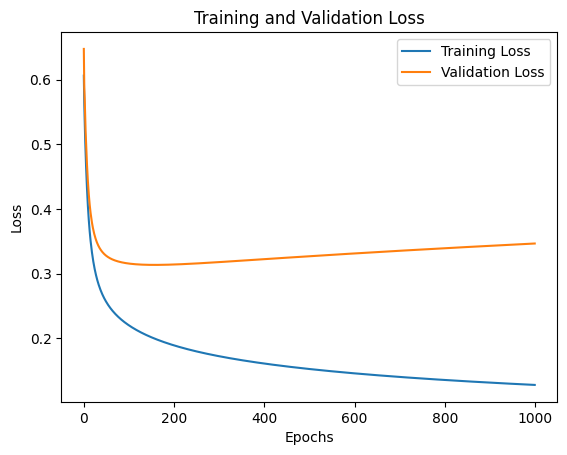

In [263]:
# Generate a sequence of integers to represent the epoch numbers
#epochs = range(1, iterations+1)
 
# Plot and label the training and validation loss values
plt.plot(J_train_history, label='Training Loss')
plt.plot(J_valid_history, label='Validation Loss')
 
# Add in a title and axes labels
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
 
# Set the tick locations
#plt.xticks(np.arange(0, iterations+1, 2))
 
# Display the plot
plt.legend(loc='best')
plt.show()

In [266]:
def predict(X, w, b):
    # number of training examples
    m, n = X.shape   
    p = np.zeros(m)
    
    for i in range(m):   
        z_wb = 0
        # Loop over each feature
        for j in range(n): 
            # Add the corresponding term to z_wb
            z_wb += X[i][j] * w[j]
        
        # Add bias term 
        z_wb += b
        
        # Calculate the prediction for this example
        f_wb = sigmoid(z_wb)

        # Apply the threshold
        p[i] = f_wb >= 0.5
        
    return p

In [267]:
y_predicted = predict(x_train, w_final, b_final)

C:\Users\alexa\AppData\Local\Temp\ipykernel_26616\7029633.py:20: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  p[i] = f_wb >= 0.5


In [268]:
y_train.shape

(534, 1)

In [269]:
y_train.reshape(-1).shape, y_predicted.shape

((534,), (534,))

In [270]:
(y_train.reshape(-1) == y_predicted).sum()

512

In [271]:
y_train = y_train.reshape(-1)

In [272]:
(accuracy, precision, recall, specificity, f1_score, false_negative_rate, false_positive_rate) = metrics_computations(x=x_train,
                                                                                                                     y_true=y_train,
                                                                                                                     y_predicted=y_predicted)

In [273]:
print(f"[TRAIN] Accuracy: {(accuracy * 100.):.2f}% \n Precision: {(precision * 100):.2f}% \n Recall: {(recall * 100):.2f}% \n F1 Score: {(f1_score * 100.):.2f}% \n Specificity: {(specificity * 100):.2f}% \n False Positive Rate: {(false_positive_rate * 100):.2f}% \n False Negative Rate: {(false_negative_rate * 100):.2f}%")

[TRAIN] Accuracy: 95.88% 
 Precision: 92.42% 
 Recall: 78.21% 
 F1 Score: 84.72% 
 Specificity: 98.90% 
 False Positive Rate: 1.10% 
 False Negative Rate: 21.79%


In [310]:
print(f"[TRAIN] Accuracy: {(accuracy * 100.):.2f}% \n Precision: {(precision * 100):.2f}% \n Recall: {(recall * 100):.2f}% \n F1 Score: {(f1_score * 100.):.2f}% \n Specificity: {(specificity * 100):.2f}% \n False Positive Rate: {(false_positive_rate * 100):.2f}% \n False Negative Rate: {(false_negative_rate * 100):.2f}%")

[TRAIN] Accuracy: 90.81% 
 Precision: 70.38% 
 Recall: 64.54% 
 F1 Score: 67.33% 
 Specificity: 95.33% 
 False Positive Rate: 4.67% 
 False Negative Rate: 35.46%


In [274]:
y_predicted_validation = predict(x_validation, w_final, b_final)

C:\Users\alexa\AppData\Local\Temp\ipykernel_26616\7029633.py:20: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  p[i] = f_wb >= 0.5


In [275]:
y_validation = y_validation.reshape(-1)

In [276]:
(accuracy, precision, recall, specificity, f1_score, false_negative_rate, false_positive_rate) = metrics_computations(x=x_validation,
                                                                                                                     y_true=y_validation,
                                                                                                                     y_predicted=y_predicted_validation)

In [277]:
print(f"[VALID] Accuracy: {(accuracy * 100.):.2f}% \n Precision: {(precision * 100):.2f}% \n Recall: {(recall * 100):.2f}% \n F1 Score: {(f1_score * 100.):.2f}% \n Specificity: {(specificity * 100):.2f}% \n False Positive Rate: {(false_positive_rate * 100):.2f}% \n False Negative Rate: {(false_negative_rate * 100):.2f}%")

[VALID] Accuracy: 90.23% 
 Precision: 70.00% 
 Recall: 41.18% 
 F1 Score: 51.85% 
 Specificity: 97.41% 
 False Positive Rate: 2.59% 
 False Negative Rate: 58.82%


In [129]:
print(f"[VALID] Accuracy: {(accuracy * 100.):.2f}% \n Precision: {(precision * 100):.2f}% \n Recall: {(recall * 100):.2f}% \n F1 Score: {(f1_score * 100.):.2f}% \n Specificity: {(specificity * 100):.2f}% \n False Positive Rate: {(false_positive_rate * 100):.2f}% \n False Negative Rate: {(false_negative_rate * 100):.2f}%")

[VALID] Accuracy: 90.98% 
 Precision: 77.78% 
 Recall: 41.18% 
 F1 Score: 53.85% 
 Specificity: 98.28% 
 False Positive Rate: 1.72% 
 False Negative Rate: 58.82%


### Analyze the feature importance

<Axes: ylabel='Feature'>

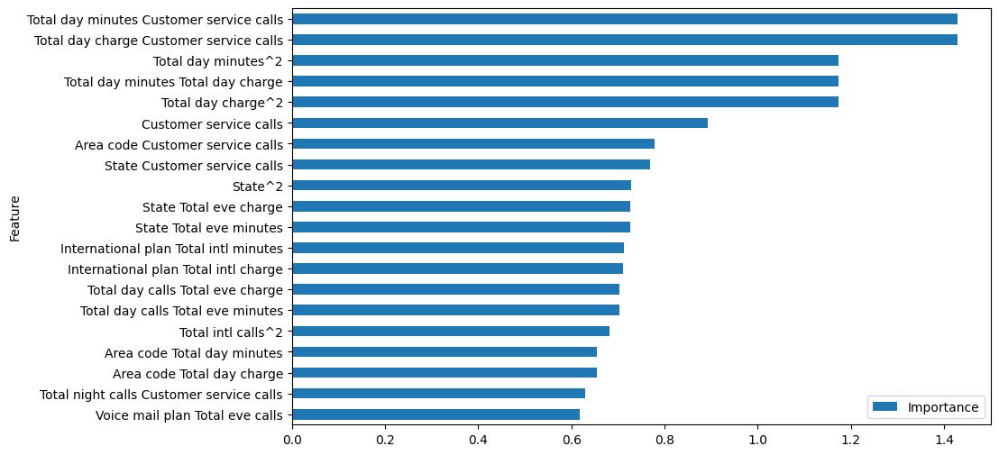

In [278]:
coefficients = copy.deepcopy(w_final)

feature_importance = pd.DataFrame({'Feature': x_data.columns.values, 'Importance': np.abs(coefficients)})
feature_importance = feature_importance.sort_values('Importance', ascending=True)
feature_importance.tail(20).plot(x='Feature', y='Importance', kind='barh', figsize=(10, 6))

#### For example most important feature is obtained by multipling two features: Total day minutes and Customer service calls

### Regularization: 
#### To adjust the overfitting from the previous polynomial model we apply Ridge L2 Regularization

In [279]:
def compute_cost_reg(X, y, w, b, lambda_ = 1):
    m, n = X.shape
    
    # Calls the compute_cost function that you implemented above
    cost_without_reg = compute_cost(X, y, w, b) 
    
    # You need to calculate this value
    reg_cost = 0.
    
    for j in range(n):
      reg_cost += w[j]**2 # Your code here to calculate the cost from w[j]
    
    # Add the regularization cost to get the total cost
    total_cost = cost_without_reg + (lambda_ / (2 * m)) * reg_cost

    return total_cost

In [280]:
def compute_gradient_reg(x_train, y_train, w, b, lambda_=1):
    m, n = x_train.shape
    
    dj_db, dj_dw = compute_gradient(x_train, y_train, w, b)
    
    for j in range(n):
        # Add the regularization term  to the correspoding element of dj_dw
        dj_dw[j] += (lambda_ / m) * w[j] # Your code here to calculate the regularization term for dj_dw[j]
        
    return dj_db, dj_dw

In [281]:
def gradient_descent(x_train, y_train, x_validation, y_validation, w_in, b_in, cost_function, gradient_function, alpha, num_iters, lambda_=1):    
    # number of training examples
    m = len(x_train)
    
    # An array to store cost J and w's at each iteration primarily for graphing later
    J_train_history = []
    J_valid_history = []
    w_history = []

    best_train_score = cost_function(x_train, y_train, w_in, b_in, lambda_)
    best_validation_score = cost_valid =  compute_cost(x_validation, y_validation, w_in, b_in, lambda_)
    best_w_in_train = copy.deepcopy(w_in)
    best_b_train = copy.deepcopy(b_in)
    best_w_in_valid = copy.deepcopy(w_in)
    best_b_valid = copy.deepcopy(b_in)
    
    for i in range(num_iters):
        
        # Calculate the gradient and update the parameters
        dj_db, dj_dw = gradient_function(x_train, y_train, w_in, b_in, lambda_)   

        # Update Parameters using w, b, alpha and gradient
        w_in = w_in - alpha * dj_dw               
        b_in = b_in - alpha * dj_db              
        
        cost_train =  cost_function(x_train, y_train, w_in, b_in, lambda_)
        J_train_history.append(cost_train)

        cost_valid =  compute_cost(x_validation, y_validation, w_in, b_in, lambda_)
        J_valid_history.append(cost_valid)

        if best_train_score > cost_train:
            best_train_score = cost_train
            np.save(f'model/best_reg_poly_train_w_in.npy', w_in)    # .npy extension is added if not given
            np.save(f'model/best_reg_poly_train_b.npy', b_in) 


        if best_validation_score > cost_valid:
            best_validation_score = cost_valid
            np.save(f'model/best_reg_poly_valid_w_in.npy', w_in)    # .npy extension is added if not given
            np.save(f'model/best_reg_poly_valid_b.npy', b_in) 
        
        # Print cost every at intervals 10 times or as many iterations if < 10
        if i % math.ceil(num_iters/10) == 0 or i == (num_iters-1):
            w_history.append(w_in)
            print(f"Iteration {i:4}: Cost Train: {float(J_train_history[-1].squeeze()):f} \t  Cost Validation: {float(J_valid_history[-1].squeeze()):f}")
        
    return w_in, b_in, J_train_history, J_valid_history, w_history #return w and J,w history for graphing

In [315]:
np.random.seed(1)
initial_w = np.random.rand(len(x_train[0]))
initial_b = np.random.rand(1)

initial_w = np.zeros(len(x_train[0]))
initial_b = 0

# Some gradient descent settings
iterations = 1000
alpha = 0.3
lambda_ = 7

w_final, b_final, J_train_history, J_valid_history, _ = gradient_descent(x_train=x_train, y_train=y_train, x_validation=x_validation, y_validation=y_validation, w_in=initial_w, b_in=initial_b, cost_function=compute_cost_reg, gradient_function=compute_gradient_reg, alpha=alpha, num_iters=iterations, lambda_=lambda_)

Iteration    0: Cost Train: 0.606675 	  Cost Validation: 0.647648
Iteration  100: Cost Train: 0.238445 	  Cost Validation: 0.319003
Iteration  200: Cost Train: 0.226254 	  Cost Validation: 0.317430
Iteration  300: Cost Train: 0.223502 	  Cost Validation: 0.318126
Iteration  400: Cost Train: 0.222710 	  Cost Validation: 0.318746
Iteration  500: Cost Train: 0.222454 	  Cost Validation: 0.319151
Iteration  600: Cost Train: 0.222365 	  Cost Validation: 0.319403
Iteration  700: Cost Train: 0.222332 	  Cost Validation: 0.319558
Iteration  800: Cost Train: 0.222320 	  Cost Validation: 0.319656
Iteration  900: Cost Train: 0.222315 	  Cost Validation: 0.319717
Iteration  999: Cost Train: 0.222313 	  Cost Validation: 0.319756


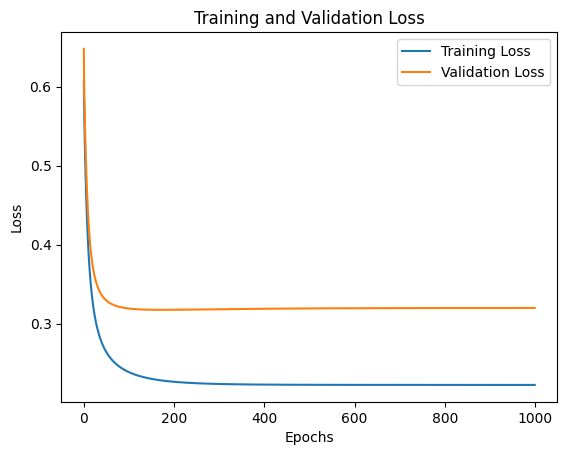

In [316]:
# Generate a sequence of integers to represent the epoch numbers
#epochs = range(1, iterations+1)
 
# Plot and label the training and validation loss values
plt.plot(J_train_history, label='Training Loss')
plt.plot(J_valid_history, label='Validation Loss')
 
# Add in a title and axes labels
plt.title('Training and Validation Loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
 
# Set the tick locations
#plt.xticks(np.arange(0, iterations+1, 2))
 
# Display the plot
plt.legend(loc='best')
plt.show()

In [317]:
best_reg_poly_w_final = np.load('model/best_reg_poly_valid_w_in.npy')
best_reg_poly_b_final = np.load('model/best_reg_poly_valid_b.npy')

In [318]:
def predict(X, w, b):
    # number of training examples
    m, n = X.shape   
    p = np.zeros(m)
    
    for i in range(m):   
        z_wb = 0
        # Loop over each feature
        for j in range(n): 
            # Add the corresponding term to z_wb
            z_wb += X[i][j] * w[j]
        
        # Add bias term 
        z_wb += b
        
        # Calculate the prediction for this example
        f_wb = sigmoid(z_wb)

        # Apply the threshold
        p[i] = f_wb >= 0.5
        
    return p

In [319]:
y_predicted = predict(x_train, w_final, b_final)

In [320]:
y_train.shape

(534,)

In [321]:
y_train.reshape(-1).shape, y_predicted.shape

((534,), (534,))

In [322]:
(y_train.reshape(-1) == y_predicted).sum()

494

In [323]:
y_train = y_train.reshape(-1)

In [324]:
(accuracy, precision, recall, specificity, f1_score, false_negative_rate, false_positive_rate) = metrics_computations(x=x_train,
                                                                                                                     y_true=y_train,
                                                                                                                     y_predicted=y_predicted)

In [292]:
print(f"[TRAIN] Accuracy: {(accuracy * 100.):.2f}% \n Precision: {(precision * 100):.2f}% \n Recall: {(recall * 100):.2f}% \n F1 Score: {(f1_score * 100.):.2f}% \n Specificity: {(specificity * 100):.2f}% \n False Positive Rate: {(false_positive_rate * 100):.2f}% \n False Negative Rate: {(false_negative_rate * 100):.2f}%")

[TRAIN] Accuracy: 92.88% 
 Precision: 84.48% 
 Recall: 62.82% 
 F1 Score: 72.06% 
 Specificity: 98.03% 
 False Positive Rate: 1.97% 
 False Negative Rate: 37.18%


In [325]:
print(f"[TRAIN] Accuracy: {(accuracy * 100.):.2f}% \n Precision: {(precision * 100):.2f}% \n Recall: {(recall * 100):.2f}% \n F1 Score: {(f1_score * 100.):.2f}% \n Specificity: {(specificity * 100):.2f}% \n False Positive Rate: {(false_positive_rate * 100):.2f}% \n False Negative Rate: {(false_negative_rate * 100):.2f}%")

[TRAIN] Accuracy: 92.51% 
 Precision: 83.93% 
 Recall: 60.26% 
 F1 Score: 70.15% 
 Specificity: 98.03% 
 False Positive Rate: 1.97% 
 False Negative Rate: 39.74%


In [326]:
def predict(X, w, b):
    # number of training examples
    m, n = X.shape   
    p = np.zeros(m)
    
    for i in range(m):   
        z_wb = 0
        # Loop over each feature
        for j in range(n): 
            # Add the corresponding term to z_wb
            z_wb += X[i][j] * w[j]
        
        # Add bias term 
        z_wb += b
        
        # Calculate the prediction for this example
        f_wb = sigmoid(z_wb)

        # Apply the threshold
        p[i] = f_wb >= 0.5
        
    return p

In [327]:
y_predicted_validation = predict(x_validation, w_final, b_final)

In [328]:
y_validation = y_validation.reshape(-1)

In [329]:
(accuracy, precision, recall, specificity, f1_score, false_negative_rate, false_positive_rate) = metrics_computations(x=x_validation,
                                                                                                                     y_true=y_validation,
                                                                                                                     y_predicted=y_predicted_validation)

In [299]:
print(f"[VALID] Accuracy: {(accuracy * 100.):.2f}% \n Precision: {(precision * 100):.2f}% \n Recall: {(recall * 100):.2f}% \n F1 Score: {(f1_score * 100.):.2f}% \n Specificity: {(specificity * 100):.2f}% \n False Positive Rate: {(false_positive_rate * 100):.2f}% \n False Negative Rate: {(false_negative_rate * 100):.2f}%")

[VALID] Accuracy: 90.23% 
 Precision: 70.00% 
 Recall: 41.18% 
 F1 Score: 51.85% 
 Specificity: 97.41% 
 False Positive Rate: 2.59% 
 False Negative Rate: 58.82%


In [331]:
print(f"[VALID] Accuracy: {(accuracy * 100.):.2f}% \n Precision: {(precision * 100):.2f}% \n Recall: {(recall * 100):.2f}% \n F1 Score: {(f1_score * 100.):.2f}% \n Specificity: {(specificity * 100):.2f}% \n False Positive Rate: {(false_positive_rate * 100):.2f}% \n False Negative Rate: {(false_negative_rate * 100):.2f}%")

[VALID] Accuracy: 90.98% 
 Precision: 77.78% 
 Recall: 41.18% 
 F1 Score: 53.85% 
 Specificity: 98.28% 
 False Positive Rate: 1.72% 
 False Negative Rate: 58.82%


### Decision Tree 
#### Specialized in learning non-linear data
#### No need for Normalization/Standardization
#### No need for Polynomial Feature Transformation

In [332]:
x_data = data.drop(columns=['Churn'])

### Split data into training and validation datasets: Default 80% train, 20% validation

In [333]:
def train_validation_split(x, y, validation_size=0.2, random_state=None):
    x_validation = x.sample(frac=validation_size, random_state=random_state)
    y_validation = y.iloc[x_validation.index]
    
    x_train = x.drop(x_validation.index)
    y_train = y.drop(y_validation.index)

    return np.array(x_train), np.array(y_train), np.array(x_validation), np.array(y_validation)

In [334]:
x_train, y_train, x_validation, y_validation = train_validation_split(x_data, y_data, validation_size=0.2, random_state=0)

### Visualize how one sample looks like

In [335]:
x_train[0]

array([ 18.  , 117.  , 408.  ,   0.  ,   0.  ,   0.  , 184.5 ,  97.  ,
        31.37, 351.6 ,  80.  ,  29.89, 215.8 ,  90.  ,   9.71,   8.7 ,
         4.  ,   2.35,   1.  ])

### Visualize the nuber of training samples and number of validation samples

In [336]:
len(y_train), len(y_validation)

(534, 133)

### Visualize the number of no churn vs churn samples in training dataset

#### Having 85.8% samples with no churn and 14.2% samples with churn in our dataset
#### So we have a ratio of 6 no churn samples to 1 churn sample
#### Our training and validation dataset should respect this ratio approximately

In [337]:
np.unique(y_train, return_counts=True)

(array([0, 1], dtype=int8), array([456,  78], dtype=int64))

#### 456 samples of 0 (no churn) and 78 samples of 1 (churn)
#### 78 * 6 = 468

### Visualize the number of no churn vs churn samples in validation dataset

#### 116 samples of 0 (no churn) and 17 samples of 1 (churn)
#### 17 * 6 = 102

In [338]:
np.unique(y_validation, return_counts=True)

(array([0, 1], dtype=int8), array([116,  17], dtype=int64))

### Decision Tree Code and Implementation

In [485]:
class Node():
    def __init__(self, feature_index=None, threshold=None, left=None, right=None, info_gain=None, value=None):
        ''' constructor ''' 
        
        # for decision node
        self.feature_index = feature_index
        self.threshold = threshold
        self.left = left
        self.right = right
        self.info_gain = info_gain
        
        # for leaf node
        self.value = value

In [512]:
class DecisionTreeClassifier():
    def __init__(self, min_samples_split=2, max_depth=2):
        ''' constructor '''
        
        # initialize the root of the tree 
        self.root = None
        
        # stopping conditions
        self.min_samples_split = min_samples_split
        self.max_depth = max_depth
        
    def build_tree(self, dataset, curr_depth=0):
        ''' recursive function to build the tree ''' 
        
        X, Y = dataset[:,:-1], dataset[:,-1]
        num_samples, num_features = np.shape(X)
        
        # split until stopping conditions are met
        if num_samples>=self.min_samples_split and curr_depth<=self.max_depth:
            # find the best split
            best_split = self.get_best_split(dataset, num_samples, num_features)
            # check if information gain is positive
            if best_split["info_gain"]>0:
                # recur left
                left_subtree = self.build_tree(best_split["dataset_left"], curr_depth+1)
                # recur right
                right_subtree = self.build_tree(best_split["dataset_right"], curr_depth+1)
                # return decision node
                return Node(best_split["feature_index"], best_split["threshold"], 
                            left_subtree, right_subtree, best_split["info_gain"])
        
        # compute leaf node
        leaf_value = self.calculate_leaf_value(Y)
        # return leaf node
        return Node(value=leaf_value)
    
    def get_best_split(self, dataset, num_samples, num_features):
        ''' function to find the best split '''
        
        # dictionary to store the best split
        best_split = {}
        max_info_gain = -float("inf")
        
        # loop over all the features
        for feature_index in range(num_features):
            feature_values = dataset[:, feature_index]
            possible_thresholds = np.unique(feature_values)
            # loop over all the feature values present in the data
            for threshold in possible_thresholds:
                # get current split
                dataset_left, dataset_right = self.split(dataset, feature_index, threshold)
                # check if childs are not null
                if len(dataset_left)>0 and len(dataset_right)>0:
                    y, left_y, right_y = dataset[:, -1], dataset_left[:, -1], dataset_right[:, -1]
                    # compute information gain
                    curr_info_gain = self.information_gain(y, left_y, right_y, "entropy")
                    # update the best split if needed
                    if curr_info_gain>max_info_gain:
                        best_split["feature_index"] = feature_index
                        best_split["threshold"] = threshold
                        best_split["dataset_left"] = dataset_left
                        best_split["dataset_right"] = dataset_right
                        best_split["info_gain"] = curr_info_gain
                        max_info_gain = curr_info_gain
                        
        # return best split
        return best_split
    
    def split(self, dataset, feature_index, threshold):
        ''' function to split the data '''
        
        dataset_left = np.array([row for row in dataset if row[feature_index]<=threshold])
        dataset_right = np.array([row for row in dataset if row[feature_index]>threshold])
        return dataset_left, dataset_right
    
    def information_gain(self, parent, l_child, r_child, mode="entropy"):
        ''' function to compute information gain '''
        
        weight_l = len(l_child) / len(parent)
        weight_r = len(r_child) / len(parent)
        if mode=="gini":
            gain = self.gini_index(parent) - (weight_l*self.gini_index(l_child) + weight_r*self.gini_index(r_child))
        else:
            gain = self.entropy(parent) - (weight_l*self.entropy(l_child) + weight_r*self.entropy(r_child))
        return gain
    
    def entropy(self, y):
        ''' function to compute entropy '''
        
        class_labels = np.unique(y)
        entropy = 0
        for cls in class_labels:
            p_cls = len(y[y == cls]) / len(y)
            entropy += -p_cls * np.log2(p_cls)
        return entropy
    
    def gini_index(self, y):
        ''' function to compute gini index '''
        
        class_labels = np.unique(y)
        gini = 0
        for cls in class_labels:
            p_cls = len(y[y == cls]) / len(y)
            gini += p_cls**2
        return 1 - gini
        
    def calculate_leaf_value(self, Y):
        ''' function to compute leaf node '''
        
        Y = list(Y)
        return max(Y, key=Y.count)
    
    def print_tree(self, features, tree=None, indent=" "):
        ''' function to print the tree '''
        
        if not tree:
            tree = self.root

        if tree.value is not None:
            print(tree.value)

        else:
            print(features[tree.feature_index], "<=", tree.threshold, "?", tree.info_gain)
            print("%sleft:" % (indent), end="")
            self.print_tree(features, tree.left, indent + indent)
            print("%sright:" % (indent), end="")
            self.print_tree(features, tree.right, indent + indent)
    
    def fit(self, X, Y):
        ''' function to train the tree '''
        
        dataset = np.concatenate((X, Y), axis=1)
        self.root = self.build_tree(dataset)
    
    def predict(self, X):
        ''' function to predict new dataset '''
        
        preditions = [self.make_prediction(x, self.root) for x in X]
        return preditions
    
    def make_prediction(self, x, tree):
        ''' function to predict a single data point '''
        
        if tree.value!=None: return tree.value
        feature_val = x[tree.feature_index]
        if feature_val<=tree.threshold:
            return self.make_prediction(x, tree.left)
        else:
            return self.make_prediction(x, tree.right)

#### Declare Decision Tree with corresponding Hyperparameters

In [513]:
classifier = DecisionTreeClassifier(min_samples_split=2, max_depth=7)

In [514]:
type(x_train)

numpy.ndarray

#### Train the Decision Tree

In [515]:
classifier.fit(x_train, y_train)

#### Predict on the training dataset 

In [516]:
y_predicted = classifier.predict(x_train)
y_predicted = np.array(y_predicted)

### Display training metrics

In [517]:
(accuracy, precision, recall, specificity, f1_score, false_negative_rate, false_positive_rate) = metrics_computations(x=x_train,
                                                                                                                     y_true=y_train.reshape(-1),
                                                                                                                     y_predicted=y_predicted)

In [518]:
print(f"[TRAIN] Accuracy: {(accuracy * 100.):.2f}% \n Precision: {(precision * 100):.2f}% \n Recall: {(recall * 100):.2f}% \n F1 Score: {(f1_score * 100.):.2f}% \n Specificity: {(specificity * 100):.2f}% \n False Positive Rate: {(false_positive_rate * 100):.2f}% \n False Negative Rate: {(false_negative_rate * 100):.2f}%")

[TRAIN] Accuracy: 99.44% 
 Precision: 98.70% 
 Recall: 97.44% 
 F1 Score: 98.06% 
 Specificity: 99.78% 
 False Positive Rate: 0.22% 
 False Negative Rate: 2.56%


In [519]:
print(f"[TRAIN] Accuracy: {(accuracy * 100.):.2f}% \n Precision: {(precision * 100):.2f}% \n Recall: {(recall * 100):.2f}% \n F1 Score: {(f1_score * 100.):.2f}% \n Specificity: {(specificity * 100):.2f}% \n False Positive Rate: {(false_positive_rate * 100):.2f}% \n False Negative Rate: {(false_negative_rate * 100):.2f}%")

[TRAIN] Accuracy: 99.44% 
 Precision: 98.70% 
 Recall: 97.44% 
 F1 Score: 98.06% 
 Specificity: 99.78% 
 False Positive Rate: 0.22% 
 False Negative Rate: 2.56%


### Display validation metrics

In [520]:
y_predicted_valid = classifier.predict(x_validation)
y_predicted_valid = np.array(y_predicted_valid)

In [521]:
(accuracy, precision, recall, specificity, f1_score, false_negative_rate, false_positive_rate) = metrics_computations(x=x_validation,
                                                                                                                     y_true=y_validation.reshape(-1),
                                                                                                                     y_predicted=y_predicted_valid)

In [522]:
print(f"[VALID] Accuracy: {(accuracy * 100.):.2f}% \n Precision: {(precision * 100):.2f}% \n Recall: {(recall * 100):.2f}% \n F1 Score: {(f1_score * 100.):.2f}% \n Specificity: {(specificity * 100):.2f}% \n False Positive Rate: {(false_positive_rate * 100):.2f}% \n False Negative Rate: {(false_negative_rate * 100):.2f}%")

[VALID] Accuracy: 90.98% 
 Precision: 64.71% 
 Recall: 64.71% 
 F1 Score: 64.71% 
 Specificity: 94.83% 
 False Positive Rate: 5.17% 
 False Negative Rate: 35.29%


In [523]:
print(f"[VALID] Accuracy: {(accuracy * 100.):.2f}% \n Precision: {(precision * 100):.2f}% \n Recall: {(recall * 100):.2f}% \n F1 Score: {(f1_score * 100.):.2f}% \n Specificity: {(specificity * 100):.2f}% \n False Positive Rate: {(false_positive_rate * 100):.2f}% \n False Negative Rate: {(false_negative_rate * 100):.2f}%")

[VALID] Accuracy: 90.98% 
 Precision: 64.71% 
 Recall: 64.71% 
 F1 Score: 64.71% 
 Specificity: 94.83% 
 False Positive Rate: 5.17% 
 False Negative Rate: 35.29%


### Display Decision Tree and Learned rules by the Tree 

In [524]:
list(x_data.columns)

['State',
 'Account length',
 'Area code',
 'International plan',
 'Voice mail plan',
 'Number vmail messages',
 'Total day minutes',
 'Total day calls',
 'Total day charge',
 'Total eve minutes',
 'Total eve calls',
 'Total eve charge',
 'Total night minutes',
 'Total night calls',
 'Total night charge',
 'Total intl minutes',
 'Total intl calls',
 'Total intl charge',
 'Customer service calls']

In [525]:
classifier.print_tree(features=list(x_data.columns))

Total day minutes <= 246.4 ? 0.08366004290740603
 left:Customer service calls <= 3.0 ? 0.07374536301238366
  left:Total eve minutes <= 275.4 ? 0.061027994750512626
    left:International plan <= 0.0 ? 0.037525855866111346
        left:Total night minutes <= 206.6 ? 0.022495934399945003
                left:0.0
                right:Total eve minutes <= 243.2 ? 0.04266292389248816
                                left:Account length <= 161.0 ? 0.048494665430836414
                                                                left:0.0
                                                                right:Total night minutes <= 212.3 ? 0.38285033974200744
                                                                                                                                left:1.0
                                                                                                                                right:0.0
                                right:Total day minutes <= 230.7

In [578]:
from sklearn.tree import DecisionTreeClassifier, export_text
from sklearn.metrics import accuracy_score

cf= DecisionTreeClassifier(criterion='entropy', max_depth=5, random_state=0)  
cf.fit(x_train, y_train)  

DecisionTreeClassifier(criterion='entropy', max_depth=5, random_state=0)

In [579]:
y_predicted = cf.predict(x_train) 

In [580]:
(accuracy, precision, recall, specificity, f1_score, false_negative_rate, false_positive_rate) = metrics_computations(x=x_train,
                                                                                                                     y_true=y_train.reshape(-1),
                                                                                                                     y_predicted=y_predicted)

In [581]:
print(f"[TRAIN] Accuracy: {(accuracy * 100.):.2f}% \n Precision: {(precision * 100):.2f}% \n Recall: {(recall * 100):.2f}% \n F1 Score: {(f1_score * 100.):.2f}% \n Specificity: {(specificity * 100):.2f}% \n False Positive Rate: {(false_positive_rate * 100):.2f}% \n False Negative Rate: {(false_negative_rate * 100):.2f}%")

[TRAIN] Accuracy: 97.75% 
 Precision: 100.00% 
 Recall: 84.62% 
 F1 Score: 91.67% 
 Specificity: 100.00% 
 False Positive Rate: 0.00% 
 False Negative Rate: 15.38%


In [582]:
y_predicted_valid = cf.predict(x_validation)
accuracy_score(y_validation, y_predicted_valid)

0.9022556390977443

In [576]:
(accuracy, precision, recall, specificity, f1_score, false_negative_rate, false_positive_rate) = metrics_computations(x=x_validation,
                                                                                                                     y_true=y_validation.reshape(-1),
                                                                                                                     y_predicted=y_predicted_valid)

In [577]:
print(f"[VALID] Accuracy: {(accuracy * 100.):.2f}% \n Precision: {(precision * 100):.2f}% \n Recall: {(recall * 100):.2f}% \n F1 Score: {(f1_score * 100.):.2f}% \n Specificity: {(specificity * 100):.2f}% \n False Positive Rate: {(false_positive_rate * 100):.2f}% \n False Negative Rate: {(false_negative_rate * 100):.2f}%")

[VALID] Accuracy: 87.97% 
 Precision: 52.94% 
 Recall: 52.94% 
 F1 Score: 52.94% 
 Specificity: 93.10% 
 False Positive Rate: 6.90% 
 False Negative Rate: 47.06%


In [561]:
from sklearn.tree import plot_tree


In [562]:
fig, axes = plt.subplots(nrows = 1,ncols = 1, figsize=(70,50), dpi=300)
plot_tree(cf, filled=True, fontsize=20, feature_names=list(x_data.columns),rounded=True, ax=axes)
plt.savefig('decisionTree.png')

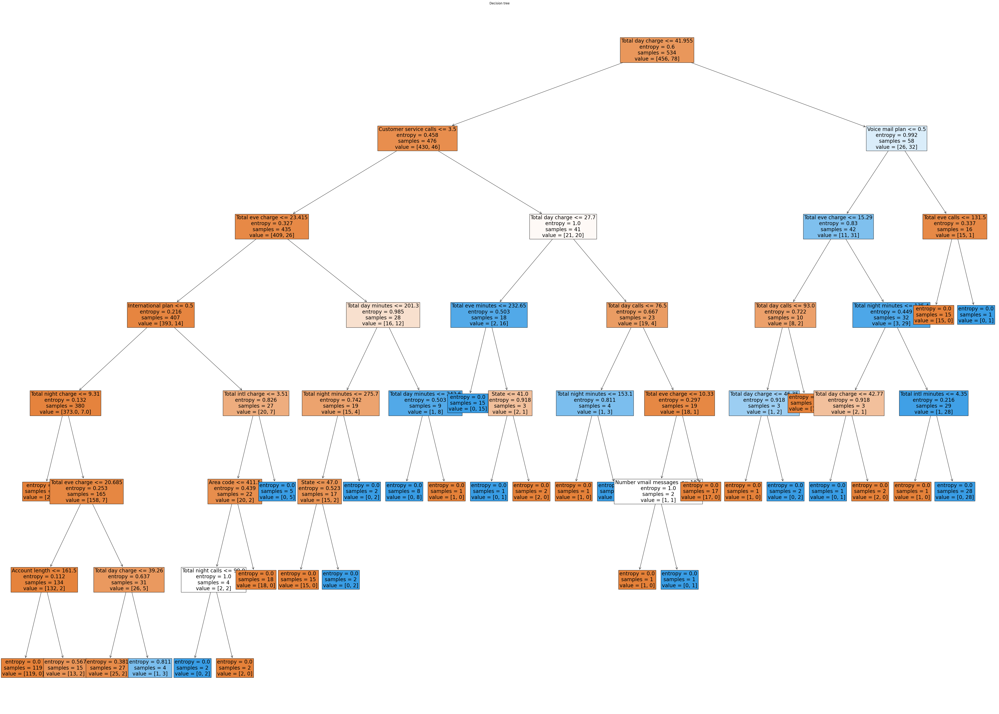

In [563]:
plt.figure(figsize=(70,50))  # set plot size (denoted in inches)
plot_tree(cf, filled=True, fontsize=20, feature_names=list(x_data.columns))
plt.title("Decision tree")
plt.show()

In [454]:
text_representation = export_text(cf, feature_names=list(x_data.columns), class_names=['No Churn', 'Churn'])
print(text_representation)

|--- Total day charge <= 41.95
|   |--- Customer service calls <= 3.50
|   |   |--- Total eve minutes <= 275.45
|   |   |   |--- International plan <= 0.50
|   |   |   |   |--- Total night minutes <= 206.85
|   |   |   |   |   |--- class: No Churn
|   |   |   |   |--- Total night minutes >  206.85
|   |   |   |   |   |--- class: No Churn
|   |   |   |--- International plan >  0.50
|   |   |   |   |--- Total intl minutes <= 13.00
|   |   |   |   |   |--- class: No Churn
|   |   |   |   |--- Total intl minutes >  13.00
|   |   |   |   |   |--- class: Churn
|   |   |--- Total eve minutes >  275.45
|   |   |   |--- Total day charge <= 34.22
|   |   |   |   |--- Total night charge <= 12.41
|   |   |   |   |   |--- class: No Churn
|   |   |   |   |--- Total night charge >  12.41
|   |   |   |   |   |--- class: Churn
|   |   |   |--- Total day charge >  34.22
|   |   |   |   |--- Total day charge <= 41.25
|   |   |   |   |   |--- class: Churn
|   |   |   |   |--- Total day charge >  41.25
|  